# **Running Lecture 4 Codes.** (Toggle for HW1 at bottom.)

## Terminal, Importing and Reading File:

Install:
!pip install scanpy scipy umap-learn leidenalg

Data Files:
!curl https://cf.10xgenomics.com/samples/cell-exp/3.0.0/pbmc_10k_v3/pbmc_10k_v3_filtered_feature_bc_matrix.h5 -o pbmc_10k_v3_filtered_feature_bc_matrix.h5
!curl https://cf.10xgenomics.com/samples/cell-exp/6.1.0/20k_PBMC_3p_HT_nextgem_Chromium_X/20k_PBMC_3p_HT_nextgem_Chromium_X_filtered_feature_bc_matrix.h5 -o 20k_PBMC_3p_HT_nextgem_Chromium_X_filtered_feature_bc_matrix.h5

In [35]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
plt.rcParams['figure.dpi'] = 300
sc.logging.print_header()

ad10f = sc.read_10x_h5("hw1_data/pbmc_10k_v3_filtered_feature_bc_matrix.h5")
print(ad10f)
ad10f.shape
type(ad10f)


scanpy==1.10.4 anndata==0.11.3 umap==0.5.7 numpy==1.26.4 scipy==1.13.1 pandas==2.2.2 scikit-learn==1.5.1 statsmodels==0.14.2 pynndescent==0.5.13
AnnData object with n_obs × n_vars = 11769 × 33538
    var: 'gene_ids', 'feature_types', 'genome'


anndata._core.anndata.AnnData

## Slicing or subsetting: randomly select a subset of cells and genes.

In [37]:
ncells = 3
ngenes = 4
randGenes = np.random.choice(ad10f.var_names, size=ngenes, replace=False)
randCells = np.random.choice(ad10f.obs_names, size=ncells, replace=False)
print(randCells)
print(randGenes)
newAnndata = ad10f[ randCells ]
newAnndata

['GTAGATCCAACAGATA-1' 'AGGTTACAGGCCTAAG-1' 'AGTAGTCTCCCATGGG-1']
['AL683807.2' 'TMEM184A' 'C9orf106' 'PABPC3']


View of AnnData object with n_obs × n_vars = 3 × 33538
    var: 'gene_ids', 'feature_types', 'genome'

Account for errors in data processing that state a cell is expressing the same gene more than once. Scanpy doesn't like this error and can only reindex uniquely valued Index objects.

In [41]:
gname_counts = ad10f.var_names.value_counts() #counts how many times each gene (ad10f.var_names = gene names) appears
print(gname_counts)
np.any(gname_counts>1) #creates a boolean array

duplicates = gname_counts[gname_counts > 1]
print(duplicates)

ad10f.var_names_make_unique() #function ensures every gene name is unique by appenxing suffixes to names
ad10f[:, randGenes ] #: means select all cells, randGenes means select specific genes

PDE11A        2
SCO2          2
LINC01505     2
PRSS50        2
ATXN7         2
             ..
PNRC1         1
AL353135.1    1
RNGTT         1
AL139042.1    1
FAM231C       1
Name: count, Length: 33514, dtype: int64
PDE11A       2
SCO2         2
LINC01505    2
PRSS50       2
ATXN7        2
EMG1         2
CYB561D2     2
LINC01238    2
CCDC39       2
TXNRD3NB     2
ABCF2        2
HSPA14       2
TBCE         2
SOD2         2
RGS5         2
TMSB15B      2
MATR3        2
PINX1        2
POLR2J3      2
DIABLO       2
LINC02203    2
IGF2         2
H2BFS        2
COG8         2
Name: count, dtype: int64


View of AnnData object with n_obs × n_vars = 11769 × 4
    var: 'gene_ids', 'feature_types', 'genome'

In [43]:
ad10f[randCells, randGenes ]

View of AnnData object with n_obs × n_vars = 3 × 4
    var: 'gene_ids', 'feature_types', 'genome'

## Metadata.
For cells, see .obs.
For genes, see .var.


In [45]:
ad10f[randCells, randGenes ].X

<3x4 sparse matrix of type '<class 'numpy.float32'>'
	with 0 stored elements in Compressed Sparse Row format>

In [55]:
print(ad10f.obs.columns)

Index([], dtype='object')


In [57]:
ad10f.obs['sample_name'] = "sample_1"
print(ad10f.obs.columns)
print(ad10f[randCells].obs)
print(ad10f.var.columns)
print(ad10f[:,randGenes].var)

#access subsets of them with pandas dataframes
print(ad10f.var.loc[randGenes])


Index(['sample_name'], dtype='object')
                   sample_name
GTAGATCCAACAGATA-1    sample_1
AGGTTACAGGCCTAAG-1    sample_1
AGTAGTCTCCCATGGG-1    sample_1
Index(['gene_ids', 'feature_types', 'genome'], dtype='object')
                   gene_ids    feature_types  genome
AL683807.2  ENSG00000234622  Gene Expression  GRCh38
TMEM184A    ENSG00000164855  Gene Expression  GRCh38
C9orf106    ENSG00000179082  Gene Expression  GRCh38
PABPC3      ENSG00000151846  Gene Expression  GRCh38
                   gene_ids    feature_types  genome
AL683807.2  ENSG00000234622  Gene Expression  GRCh38
TMEM184A    ENSG00000164855  Gene Expression  GRCh38
C9orf106    ENSG00000179082  Gene Expression  GRCh38
PABPC3      ENSG00000151846  Gene Expression  GRCh38


## Quality Control and Filtering.

In [64]:
#detect mitochondrial and ribosomal genes and calculate QC metrics based on % reads coming from mt and ribo genes
ad10f.var['mt'] = ad10f.var_names.str.startswith('MT-')
ribo_prefix = ("RPS","RPL")
ad10f.var['ribo'] = ad10f.var_names.str.startswith(ribo_prefix)
sc.pp.calculate_qc_metrics(ad10f, qc_vars=['mt','ribo'], percent_top=None, log1p=False, inplace=True)

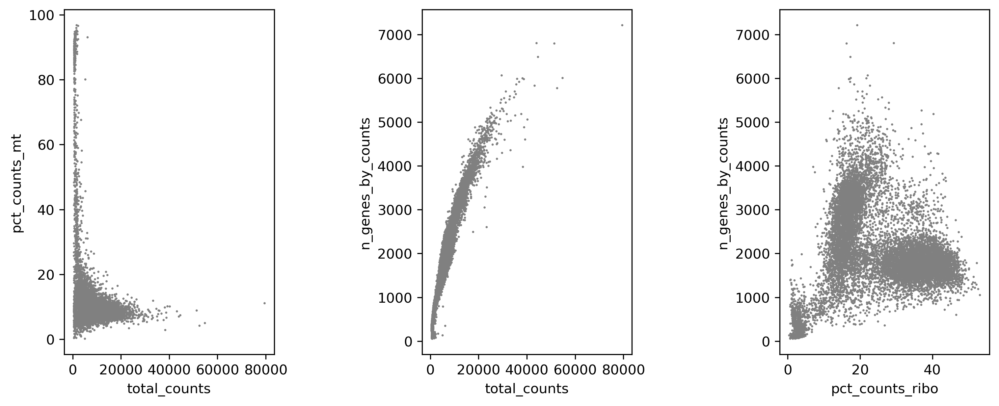

In [62]:
adClean = ad10f.copy() #new copy so filtering doesn't change original data

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10,4), gridspec_kw={'wspace':0.25}, constrained_layout=True)
#mitochondrial RNA % vs. Total Counts UMI per cell
ax1_dict = sc.pl.scatter(adClean, x='total_counts', y='pct_counts_mt', ax=ax1, show=False)

#Number of Genes Detected Per Cell vs. Total Counts RNA per cell
ax2_dict = sc.pl.scatter(adClean, x='total_counts', y='n_genes_by_counts',ax=ax2, show=False)

#% ribosomal RNA vs. Genes Detected
ax3_dict = sc.pl.scatter(adClean, x='pct_counts_ribo', y='n_genes_by_counts',ax=ax3, show=False)
plt.show()

In [66]:
adClean = adClean[adClean.obs['pct_counts_mt']<20,:].copy() #keep cells with fewer mitochondrial encoded gene total UMIs
adClean.n_obs

11047

In [68]:
sc.pp.filter_cells(adClean, min_genes=500) #total number of genes detected
sc.pp.filter_cells(adClean, max_counts=30000) #total number of counts
sc.pp.filter_genes(adClean, min_cells=3)
adClean.shape

(10891, 20181)

In [71]:
adNorm = adClean.copy()
adNorm.layers['counts'] = adNorm.X.copy()
sc.pp.normalize_total(adNorm , target_sum=1e4)
sc.pp.log1p(adNorm)

In [77]:
#determine which genes are HVG based on mean expression and dispersion
sc.pp.highly_variable_genes(adNorm, min_mean=0.0125, max_mean=6, min_disp=0.25)
adNorm.var

,gene_ids,feature_types,genome,mt,ribo,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,highly_variable,means,dispersions,dispersions_norm
AL627309.1,ENSG00000238009,Gene Expression,GRCh38,False,False,60,0.005183,99.490186,61.0,60,False,0.007519,0.595591,-0.001919
AL627309.3,ENSG00000239945,Gene Expression,GRCh38,False,False,4,0.000340,99.966012,4.0,4,False,0.000389,0.144284,-1.366927
AL669831.5,ENSG00000237491,Gene Expression,GRCh38,False,False,679,0.062367,94.230606,734.0,665,False,0.077585,0.586329,-0.029932
FAM87B,ENSG00000177757,Gene Expression,GRCh38,False,False,13,0.001190,99.889540,14.0,13,False,0.001139,0.169543,-1.290532
LINC00115,ENSG00000225880,Gene Expression,GRCh38,False,False,350,0.031269,97.026085,368.0,337,False,0.038579,0.459107,-0.414723
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC011043.1,ENSG00000276256,Gene Expression,GRCh38,False,False,77,0.006882,99.345739,81.0,74,False,0.010262,0.738345,0.429851
AL592183.1,ENSG00000273748,Gene Expression,GRCh38,False,False,32,0.002719,99.728099,32.0,30,False,0.003977,0.799225,0.613985
AC007325.4,ENSG00000278817,Gene Expression,GRCh38,False,False,239,0.020902,97.969241,246.0,233,False,0.023936,0.329110,-0.807909
AL354822.1,ENSG00000278384,Gene Expression,GRCh38,False,False,319,0.028210,97.289489,332.0,303,False,0.038089,0.594378,-0.005588


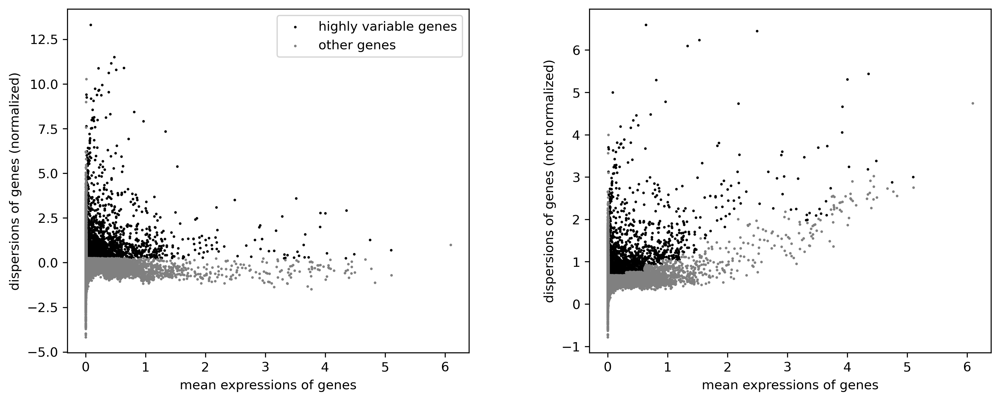

In [79]:
sc.pl.highly_variable_genes(adNorm) #normalized dispersion calculated by scaling based on a bin of mean expression

## Visualization of cell-cell similarities.

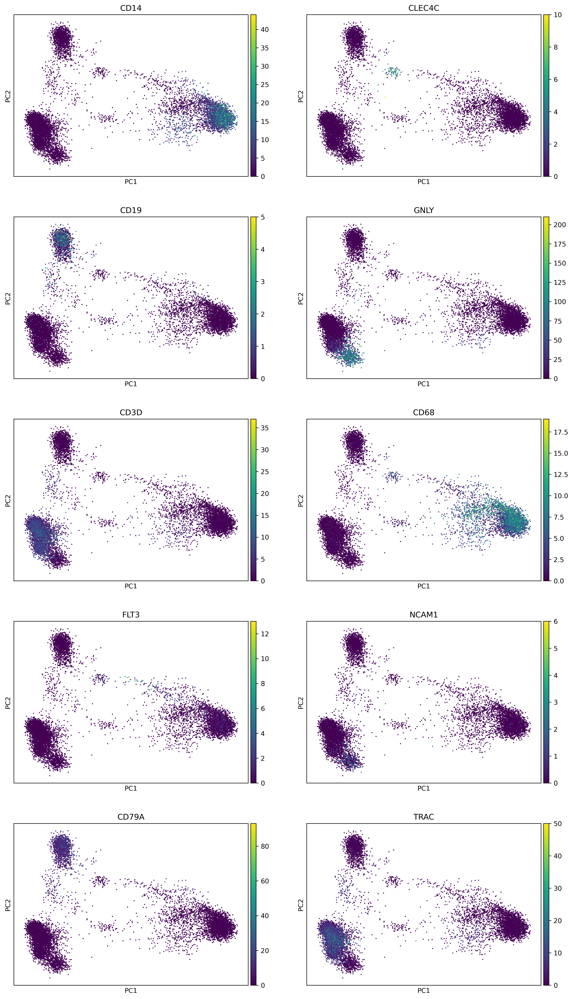

In [87]:
sc.tl.pca(adNorm , use_highly_variable=True) #dimensionality reduction PCA

markerGenes = ['CD14','CLEC4C', 'CD19',  'GNLY', 'CD3D', 'CD68', 'FLT3', 'NCAM1', 'CD79A', 'TRAC']
sc.pl.pca(adNorm , color=markerGenes, ncols=2, layer='counts') #PCA using raw counts

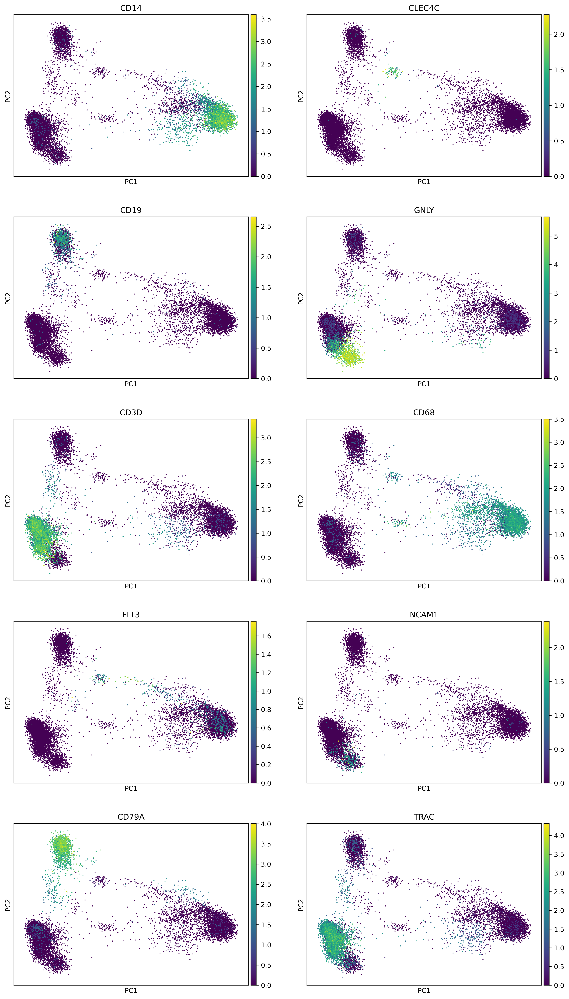

In [89]:
sc.pl.pca(adNorm , color=markerGenes, ncols=2) #PCA using normalized data

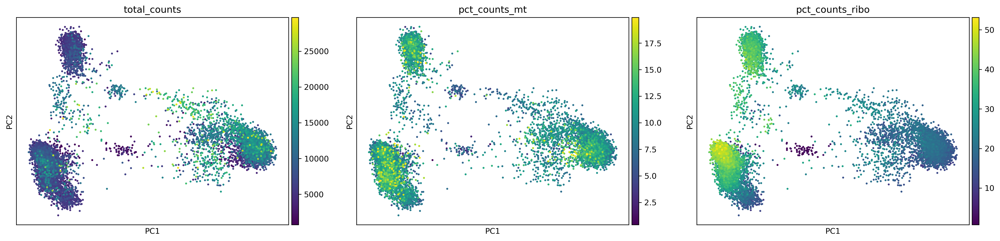

In [91]:
sc.pl.pca(adNorm, color=['total_counts', 'pct_counts_mt', 'pct_counts_ribo'], s=25,ncols=3)

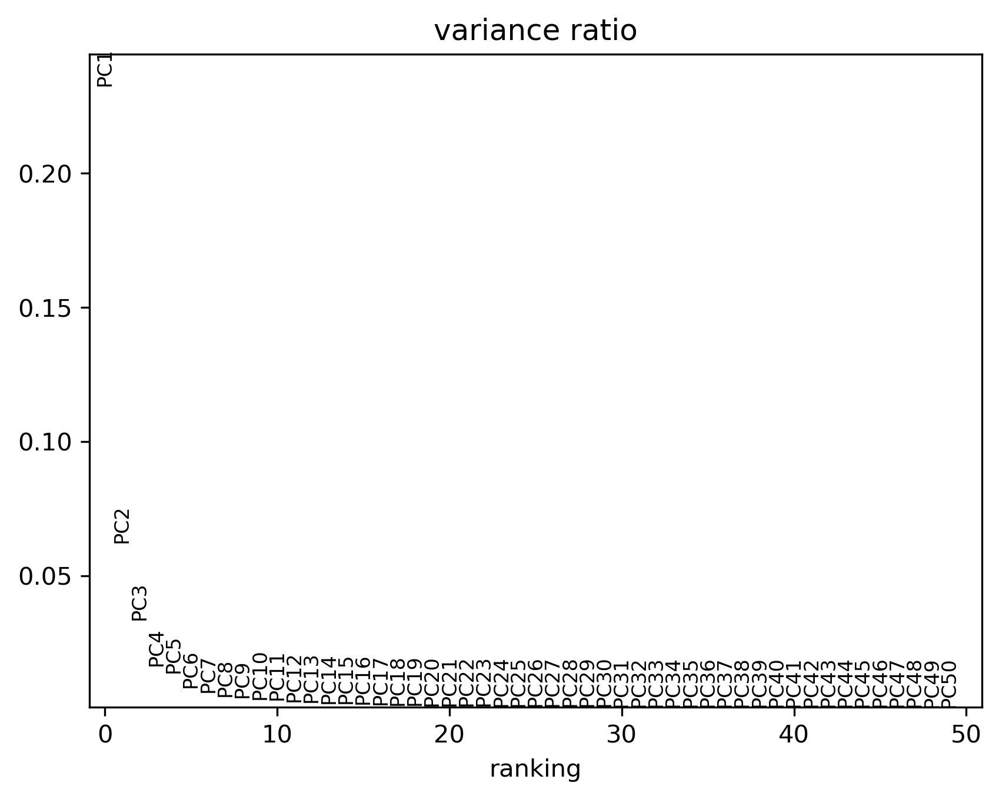

In [93]:
sc.pl.pca_variance_ratio(adNorm, 50)

In [95]:
np.shape(adNorm.varm["PCs"])

(20181, 50)

In [97]:
np.shape(adNorm.obsm["X_pca"])

(10891, 50)

In [99]:
n_neighbors = 20
n_pcs = 10
sc.pp.neighbors(adNorm, n_neighbors=n_neighbors, n_pcs=n_pcs)

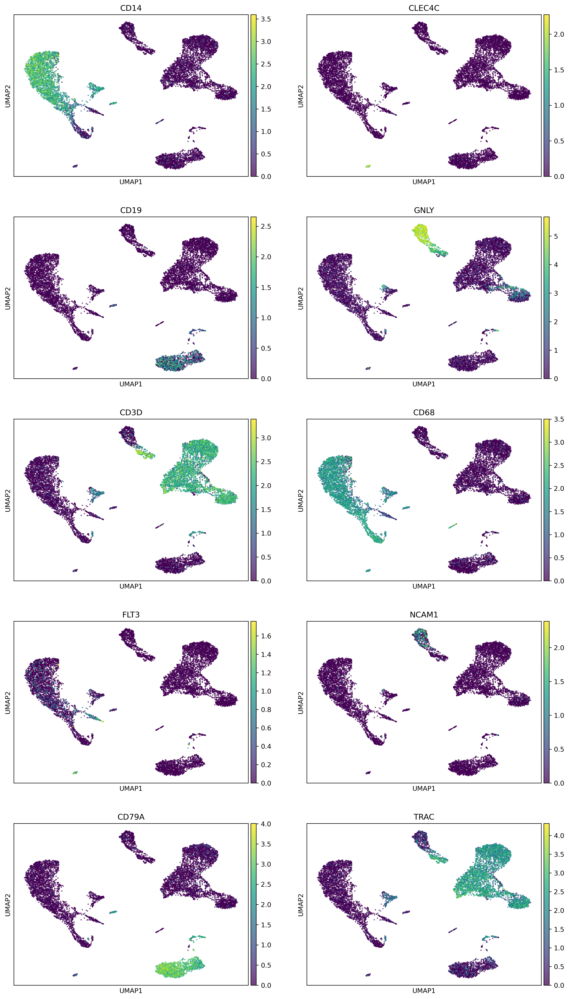

In [100]:
sc.tl.umap(adNorm, 0.25)
sc.pl.umap(adNorm, color=markerGenes, alpha=.75, s=15, ncols=2)

### Unsupervised clustering.

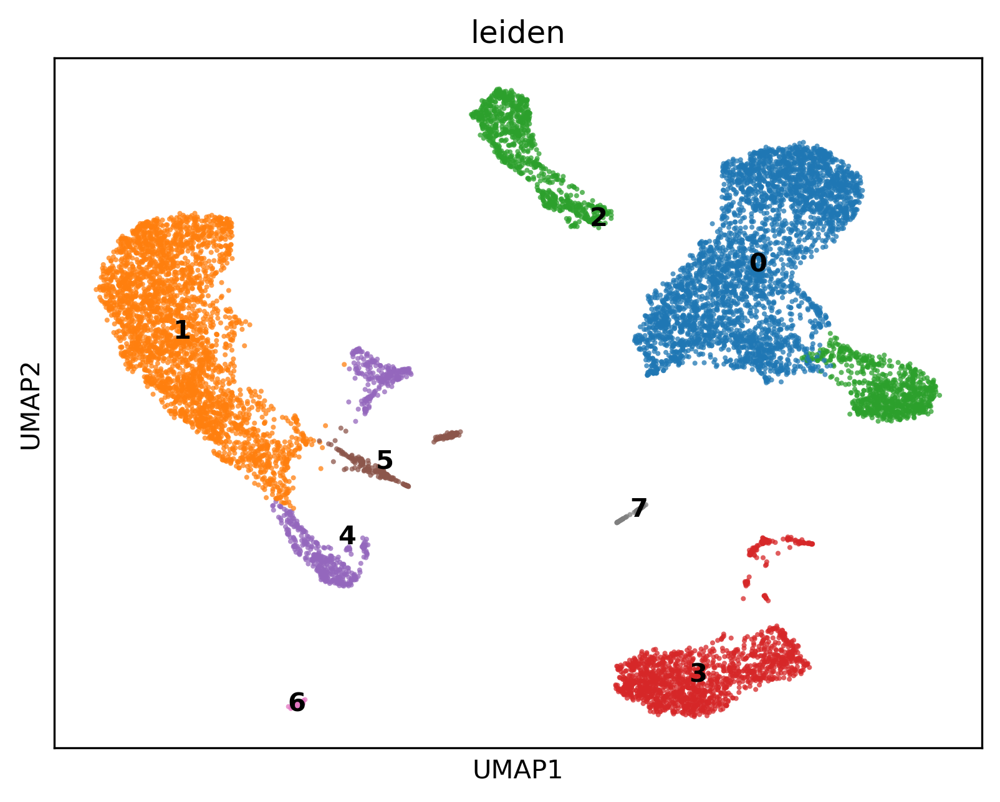

In [118]:
#First install python-igraph and leidenalg through conda install in anaconda prompt

sc.tl.leiden(adNorm,.1)
sc.pl.umap(adNorm,color=['leiden'], alpha=.75, s=15, legend_loc='on data')

### Fixing discordance between embedding and unsupervised cluster.

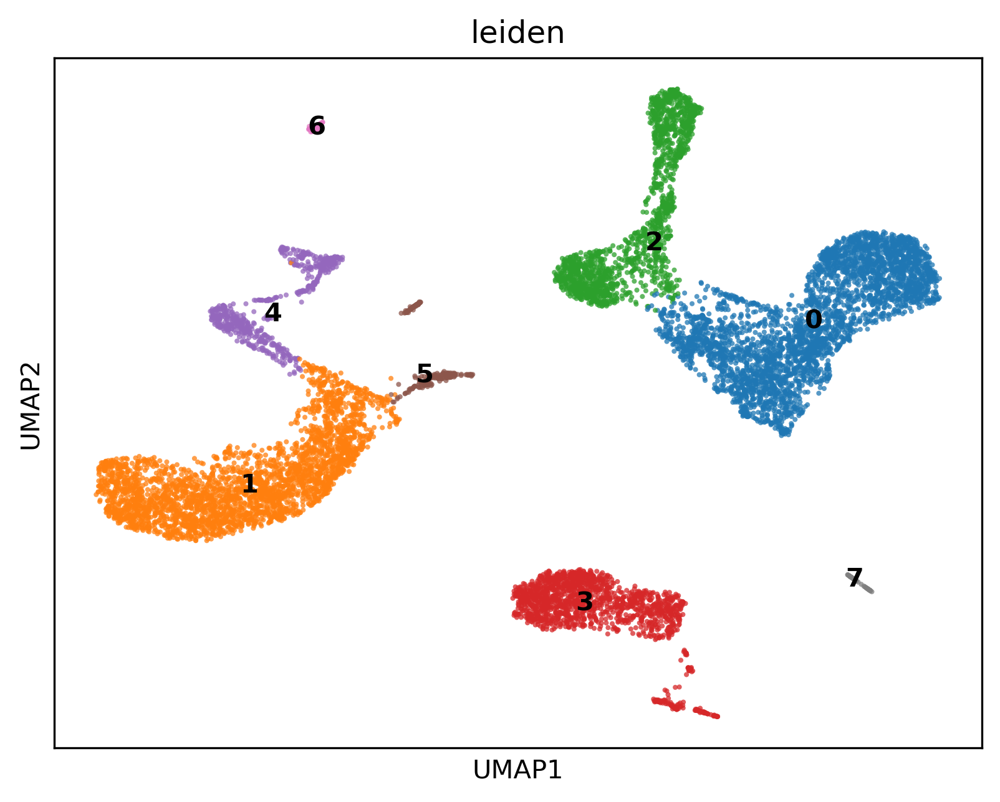

In [124]:

adNorm = adClean.copy()

## Norm, HVG, PCA, kNN
sc.pp.normalize_total(adNorm , target_sum=1e4)
sc.pp.log1p(adNorm)
sc.pp.highly_variable_genes(adNorm , min_mean=0.0125, max_mean=6, min_disp=0.25)
sc.tl.pca(adNorm , use_highly_variable=True)

n_neighbors = 20
n_pcs = 10
sc.pp.neighbors(adNorm, n_neighbors=n_neighbors, n_pcs=n_pcs)
sc.tl.leiden(adNorm,.1)
sc.tl.paga(adNorm) #compute intercluster similarities
sc.pl.paga(adNorm, plot=False) #create internal embedding based on intercluster similarities
sc.tl.umap(adNorm, 0.25, init_pos='paga') #use embedding to start optimization
sc.pl.umap(adNorm,color=['leiden'], alpha=.75, s=15, legend_loc='on data')

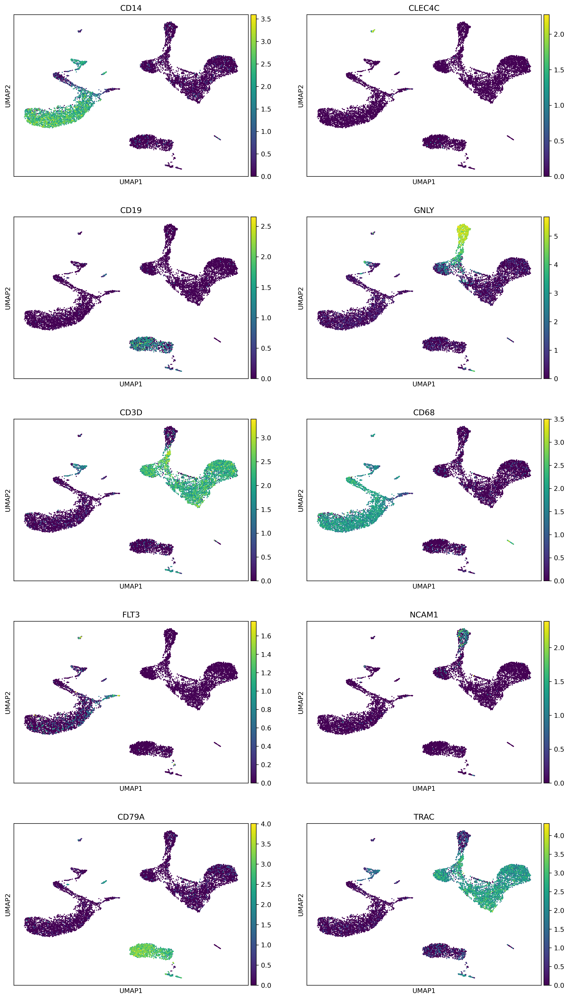

In [126]:
sc.pl.umap(adNorm , color=markerGenes, ncols=2)

categories: 0, 1, 2, etc.
var_group_labels: Monocytes, NK Cells, B Cells, etc.


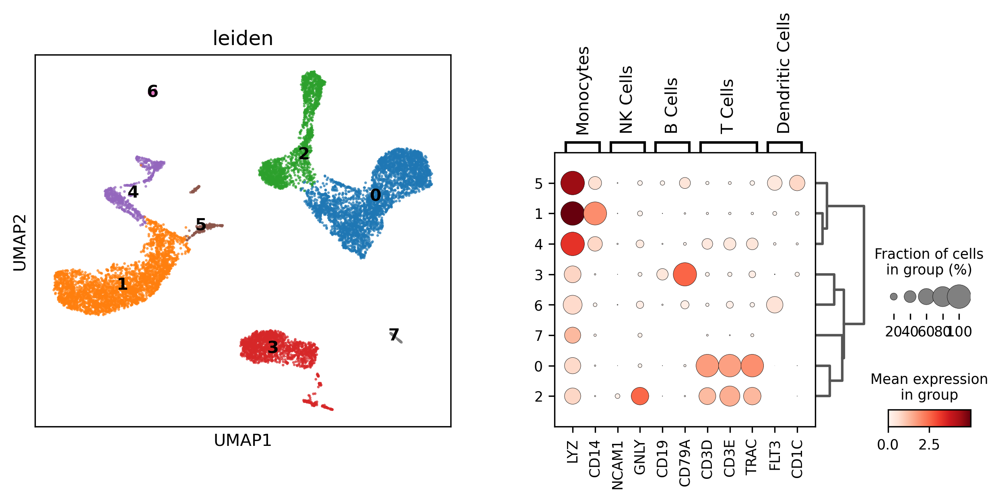

In [136]:
marker_genes_dict = {
    "Monocytes": ["LYZ", "CD14"],
    "NK Cells": ["NCAM1", "GNLY"],
    "B Cells": ["CD19", "CD79A"],
    "T Cells": ["CD3D", "CD3E", "TRAC"],
    "Dendritic Cells": ["FLT3", "CD1C"]
}

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4), gridspec_kw={'wspace':0.25})
ax1_dict = sc.pl.umap(adNorm,color=['leiden'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm, marker_genes_dict, 'leiden', dendrogram=True,ax=ax2, show=False)
plt.show()

## Cluster annotation.

Some clusters are ambiguous because they express markers of more than one cell type. This could be due to the cluster containing > 1 cell type, or because the cell barcodes are doublets. If former, we can subcluster them.


categories: 0, 1, 2, etc.
var_group_labels: Monocytes, NK Cells, B Cells, etc.


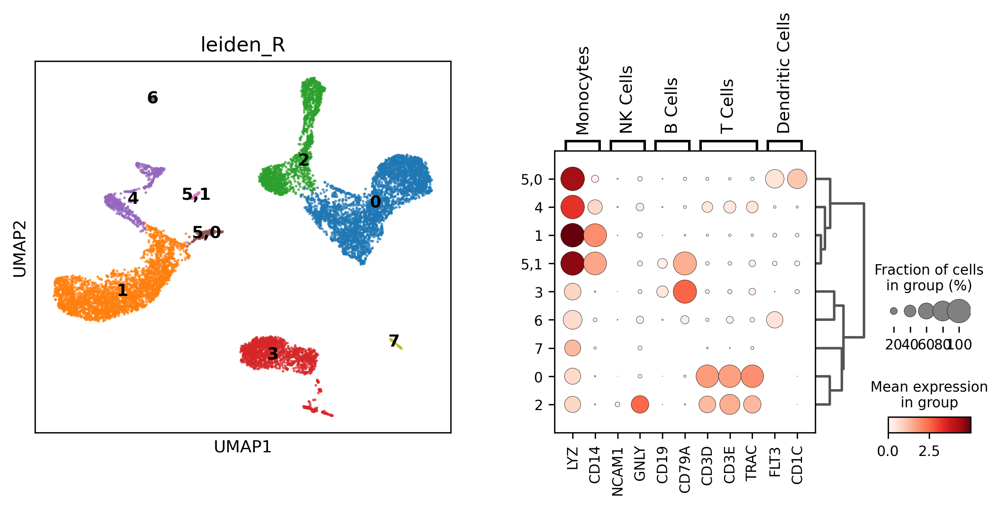

In [142]:
#refine clusters 5
sc.tl.leiden(adNorm,.1, restrict_to=["leiden",["5"]])
sc.tl.dendrogram(adNorm, "leiden_R")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4), gridspec_kw={'wspace':0.25})
ax1_dict = sc.pl.umap(adNorm,color=['leiden_R'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm, marker_genes_dict, 'leiden_R', dendrogram=True,ax=ax2, show=False)
plt.show()

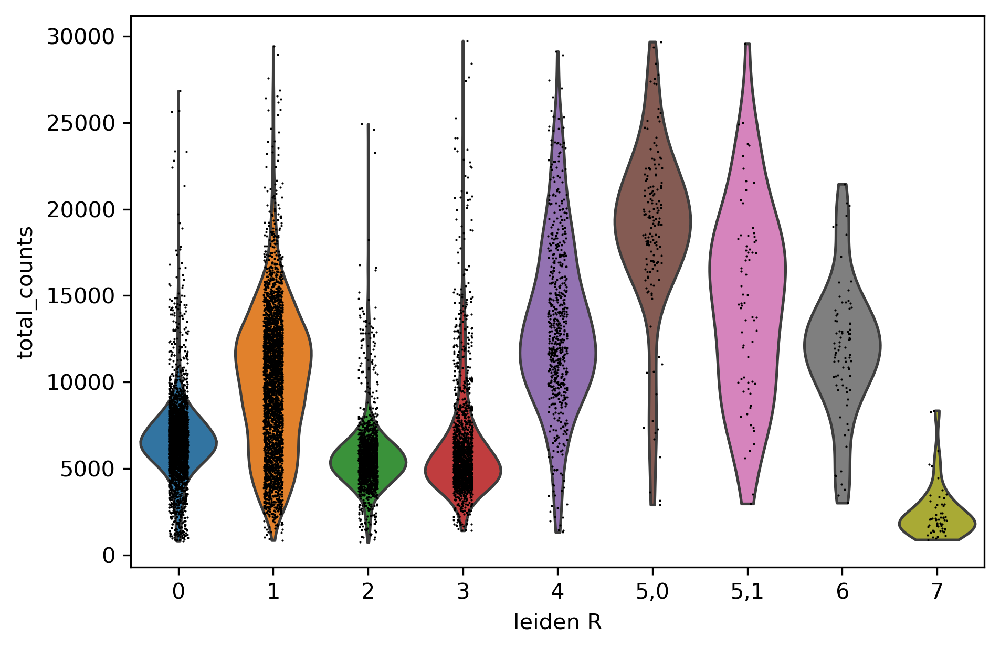

In [144]:
sc.pl.violin(adNorm, ['total_counts'], groupby='leiden_R' )

categories: 0, 1, 2,0, etc.
var_group_labels: Monocytes, NK Cells, B Cells, etc.


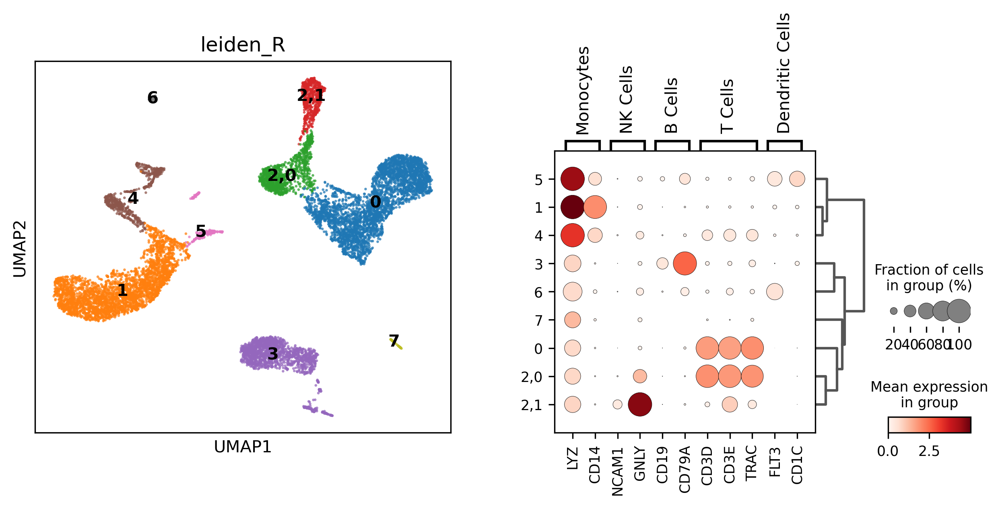

In [148]:
#cluster 2 first
sc.tl.leiden(adNorm,.05, restrict_to=["leiden",["2"]])
sc.tl.dendrogram(adNorm, "leiden_R")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4), gridspec_kw={'wspace':0.25})
ax1_dict = sc.pl.umap(adNorm,color=['leiden_R'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm, marker_genes_dict, 'leiden_R', dendrogram=True,ax=ax2, show=False)
plt.show()

categories: 0, 1, 2,0, etc.
var_group_labels: Monocytes, NK Cells, B Cells, etc.


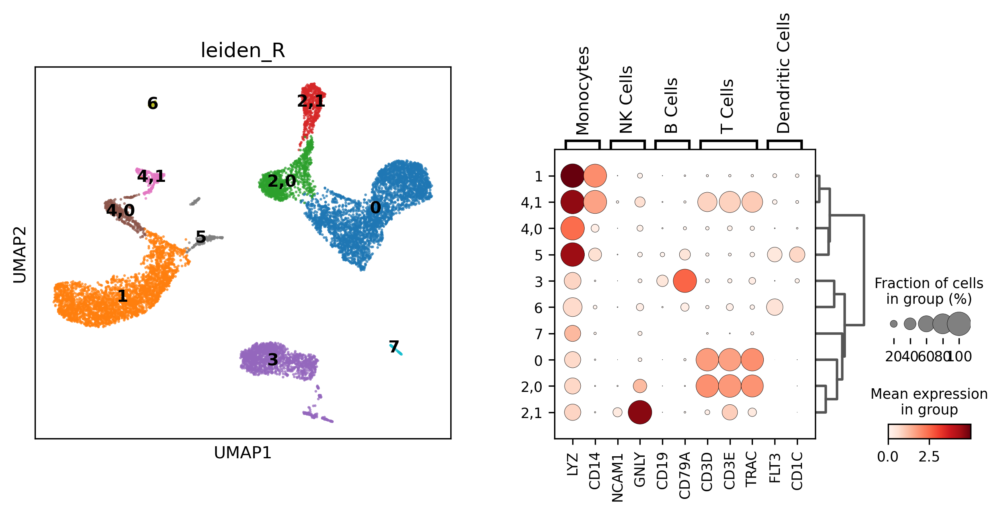

In [150]:
#refine cluster 4
sc.tl.leiden(adNorm,.1, restrict_to=["leiden_R",["4"]])
sc.tl.dendrogram(adNorm, "leiden_R")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4), gridspec_kw={'wspace':0.25})
ax1_dict = sc.pl.umap(adNorm,color=['leiden_R'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm, marker_genes_dict, 'leiden_R', dendrogram=True,ax=ax2, show=False)
plt.show()

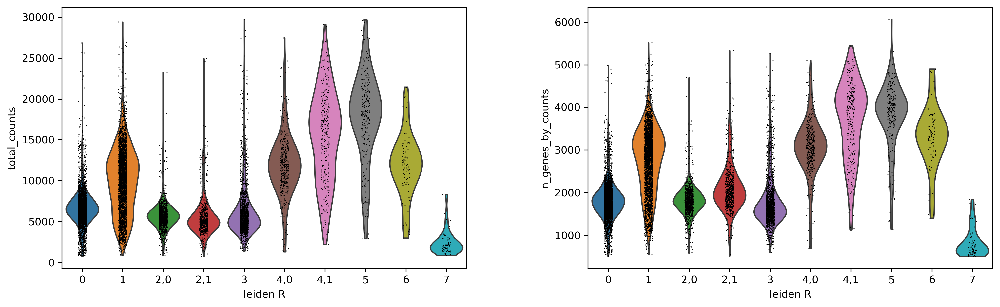

In [152]:
sc.pl.violin(adNorm, ['total_counts', 'n_genes_by_counts'], groupby='leiden_R' )

categories: 0, 1, 2,0, etc.
var_group_labels: B cell, Dendritic, CD14 monocyte, etc.


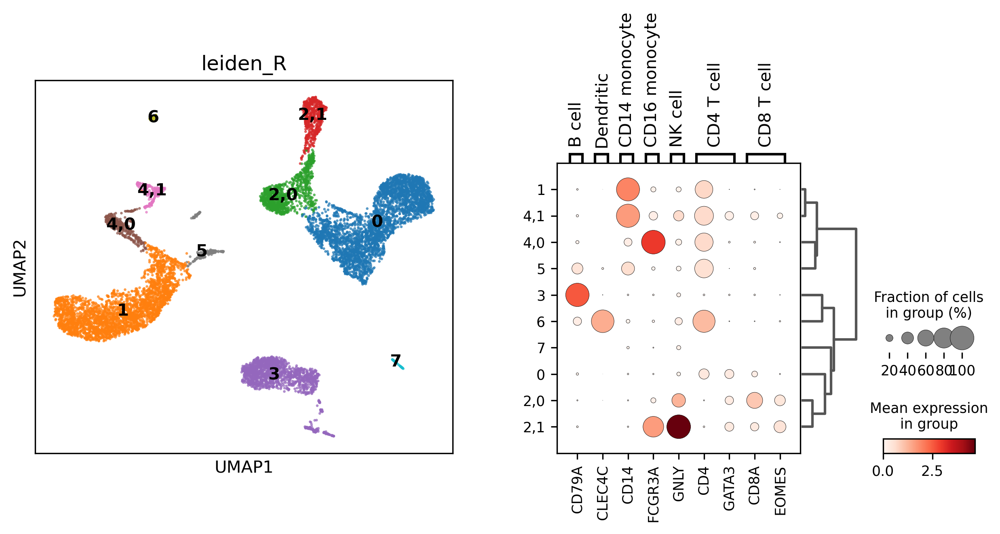

In [156]:
#two monocyte and two T cell clusters
marker_genes_sub_dict = {
    'B cell': ['CD79A'],
    'Dendritic': ['CLEC4C'],
    'CD14 monocyte': ['CD14'],
    'CD16 monocyte': ['FCGR3A'],
    'NK cell': ['GNLY'],
    'CD4 T cell': ['CD4', 'GATA3'],
    'CD8 T cell': ['CD8A', 'EOMES']
}

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4), gridspec_kw={'wspace':0.25})
ax1_dict = sc.pl.umap(adNorm,color=['leiden_R'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm, marker_genes_sub_dict, 'leiden_R', dendrogram=True,ax=ax2, show=False)
plt.show()

### Differential gene expression with cluster 7.

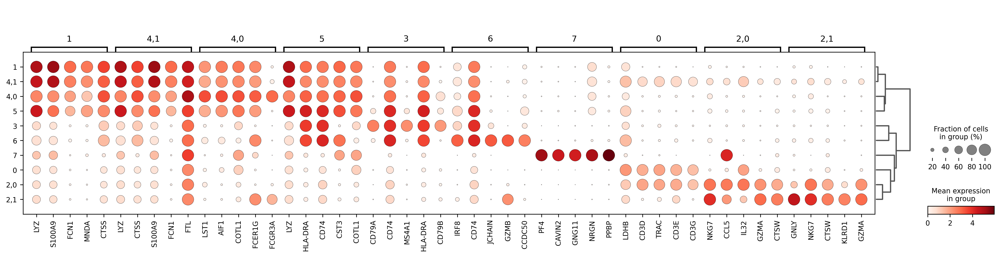

In [159]:

sc.tl.rank_genes_groups(adNorm, use_raw=False, groupby="leiden_R")
sc.pl.rank_genes_groups_dotplot(adNorm, n_genes=5, groupby="leiden_R", dendrogram=True, key='rank_genes_groups')

categories: 0, 1, 2,0, etc.
var_group_labels: 7


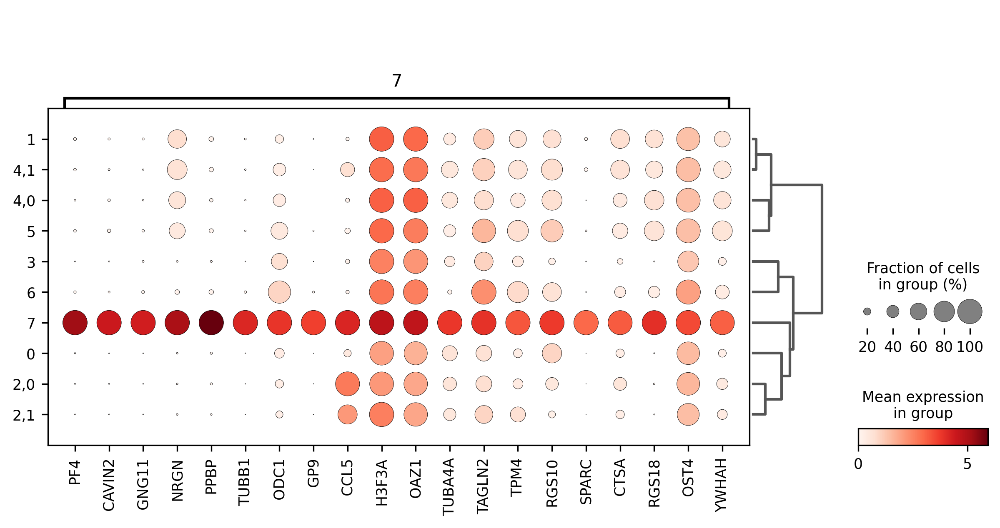

In [161]:
sc.pl.rank_genes_groups_dotplot(adNorm, n_genes=20, groupby="leiden_R", dendrogram=True, key='rank_genes_groups', groups=['7'])

In [163]:
tokeep = ["1", "4,0", "3", "6", "7", "0", "2,0", "2,1"]
adNorm2 = adNorm.copy() #create new, clean Anndata
adNorm2 = adNorm2[adNorm2.obs['leiden_R'].isin(tokeep)].copy()
adNorm2.shape
adNorm2.obs['leiden_R'].value_counts()

leiden_R
0      3563
1      3115
3      1604
2,0    1031
2,1     611
4,0     368
6        81
7        60
Name: count, dtype: int64

In [165]:
#assign the cell clusters to cell type based on mean expression data
cell_dict = {'Dendritic': ['6'],
             'CD14 Monocyte': ['1'],
             'CD16 Monocyte': ["4,0"],
             'B cell': ['3'],
             'Platelet': ['7'],
             'CD4 T cell': ['0'],
             'CD8 T cell': ["2,0"],
             'NK cell': ["2,1"]
}

#establish new marker genes to use for all the clusters
marker_genes_dict = {
    'B cell': ['CD79A'],
    'Dendritic': ['CLEC4C'],
    'CD14 monocyte': ['CD14'],
    'CD16 monocyte': ['FCGR3A'],
    'NK cell': ['GNLY'],
    'CD4 T cell': ['CD4', 'GATA3'],
    'CD8 T cell': ['CD8A', 'EOMES'],
    'Platelet': ['PF4', 'CAVIN2']
}

#make new obs column for cell type
new_obs_name = 'cell_type'

#initialize all values in the column as undefined
adNorm2.obs[new_obs_name] = np.nan 

for i in cell_dict.keys():
    ind = pd.Series(adNorm2.obs.leiden_R).isin(cell_dict[i])
    adNorm2.obs.loc[ind,new_obs_name] = i

#converting cell type column to a categorical variable
adNorm2.obs['cell_type'] = adNorm2.obs['cell_type'].astype("category") 


categories: B cell, CD14 Monocyte, CD16 Monocyte, etc.
var_group_labels: B cell, Dendritic, CD14 monocyte, etc.


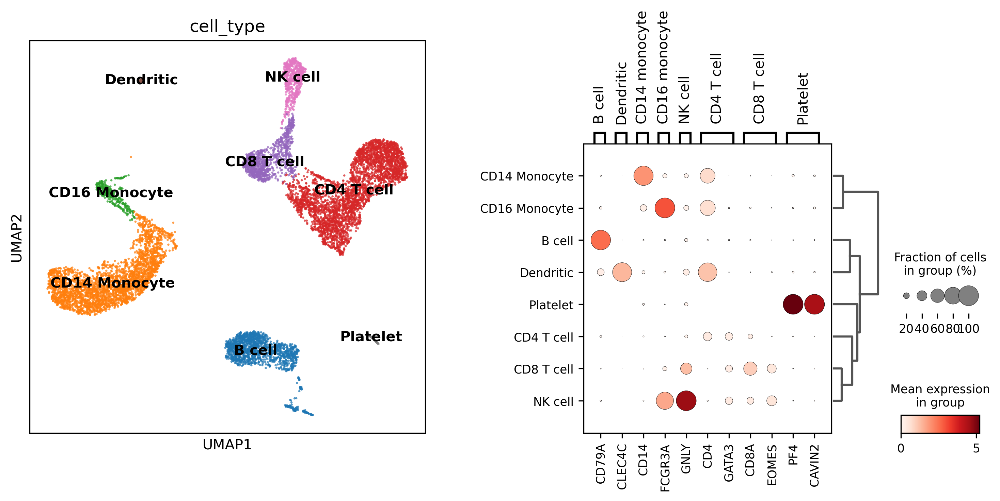

In [167]:
sc.tl.dendrogram(adNorm2, "cell_type")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,5), gridspec_kw={'wspace':0.4})
ax1_dict = sc.pl.umap(adNorm2,color=['cell_type'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm2, marker_genes_dict, 'cell_type', dendrogram=True,ax=ax2, show=False)
plt.show()


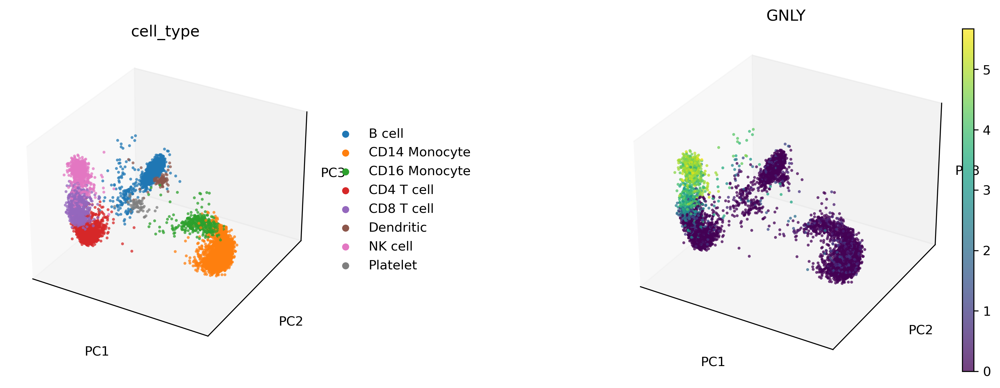

In [169]:
sc.pl.pca(adNorm2, color=['cell_type', 'GNLY'], alpha=.75, s=15, projection='3d')

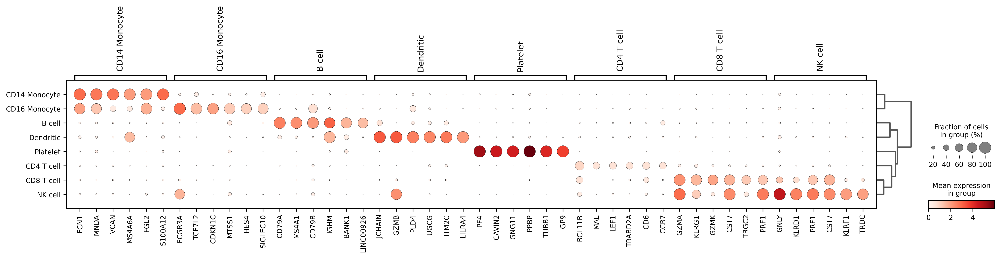

In [173]:
#remove any likely doublets by identifying genes preferntially expressed in each cluster vs all the others
sc.tl.rank_genes_groups(adNorm2, use_raw=False, groupby="cell_type")

#only display genes that meet criteria
sc.tl.filter_rank_genes_groups(adNorm2, min_fold_change=.7, min_in_group_fraction=.5, max_out_group_fraction=.15)

#dot plot of differentially expressed genes
sc.pl.rank_genes_groups_dotplot(adNorm2, n_genes=6, groupby="cell_type", dendrogram=True, key='rank_genes_groups_filtered')

# HW 1
## Question 1.

### What is the cell type composition of PBMCs of Sample 1?


**Deliverable 1: Showing the new .obs column (last column) indicating cell type for each cell based on the AnnData adNorm2.**

In [175]:
adNorm2.obs

,sample_name,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,n_genes,n_counts,leiden,leiden_R,cell_type
AAACCCAAGCGCCCAT-1,sample_1,1087,2204.0,52.0,2.359347,392.0,17.785845,1087,2204.0,0,0,CD4 T cell
AAACCCACAGAGTTGG-1,sample_1,1836,5884.0,633.0,10.757988,1043.0,17.726036,1836,5884.0,1,1,CD14 Monocyte
AAACCCACAGGTATGG-1,sample_1,2216,5530.0,434.0,7.848101,742.0,13.417721,2216,5530.0,2,"2,1",NK cell
AAACCCACATAGTCAC-1,sample_1,1615,5106.0,553.0,10.830396,1734.0,33.960049,1615,5106.0,3,3,B cell
AAACCCACATCCAATG-1,sample_1,1800,4572.0,411.0,8.989501,871.0,19.050745,1800,4572.0,2,"2,1",NK cell
...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTGCGTCGT-1,sample_1,1336,5115.0,365.0,7.135875,2471.0,48.308895,1336,5115.0,0,0,CD4 T cell
TTTGTTGGTGTCATGT-1,sample_1,1331,3937.0,783.0,19.888241,606.0,15.392430,1331,3937.0,1,1,CD14 Monocyte
TTTGTTGGTTTGAACC-1,sample_1,1401,4245.0,375.0,8.833922,1402.0,33.027092,1401,4245.0,2,"2,0",CD8 T cell
TTTGTTGTCCAAGCCG-1,sample_1,1668,5602.0,524.0,9.353803,1985.0,35.433773,1668,5602.0,0,0,CD4 T cell


**Deliverable 2: Visualization of cluster-labeled UMAP and marker gene expressions in dotplot.**

Here we are only keeping a few of the Leiden clusters (discarding doublet cell type cluster 5 and the multiplet group 4,1 because the cell barcodes are doublets) for labelling and recreating the AnnData object, adNorm2, which is a copy of the normalized AnnData read from the .h5 file with Scanpy.

We then only return cells that have matches in the Leiden cluster assignment and the to keep cluster list and create a copy of that as the new adNorm2 for further analysis, ensuring we only look at the kept clusters.

We then check the shape and can count the number of cells that belong to each of the clusters we wanted to look at.

In [186]:
tokeep = ["1", "4,0", "3", "6", "7", "0", "2,0", "2,1"]
adNorm2 = adNorm.copy() #create new, clean Anndata
adNorm2 = adNorm2[adNorm2.obs['leiden_R'].isin(tokeep)].copy()
adNorm2.shape
adNorm2.obs['leiden_R'].value_counts()

leiden_R
0      3563
1      3115
3      1604
2,0    1031
2,1     611
4,0     368
6        81
7        60
Name: count, dtype: int64

To make the cell groups easier to read, we can label the groups according to their actual cell type name in the following dictionary based off the mean expression data in the dotplot from earlier analysis.

We then establish one marker that indicates each cell type in a new dictionary and can be used later for the dot plot of marker gene expression across the cell types.

Finally, we make the new column (shown above in Deliverable 1) for cell type and use a for loop to loop through each of the cell types in the cell_dict and find all cells in the given Leiden cluster (cell_dict[i]). ind is a Boolean mask that when ind is True for that row, it will add the cell type name (i) for that row in the .obs column.

We also convert the column to a categorical variable because they take up less memory and are easier for pandas and scanpy visualization.

In [190]:
#assign the cell clusters to cell type based on mean expression data
cell_dict = {'Dendritic': ['6'],
             'CD14 Monocyte': ['1'],
             'CD16 Monocyte': ["4,0"],
             'B cell': ['3'],
             'Platelet': ['7'],
             'CD4 T cell': ['0'],
             'CD8 T cell': ["2,0"],
             'NK cell': ["2,1"]
}

#establish new marker genes to use for all the clusters
marker_genes_dict = {
    'B cell': ['CD79A'],
    'Dendritic': ['CLEC4C'],
    'CD14 monocyte': ['CD14'],
    'CD16 monocyte': ['FCGR3A'],
    'NK cell': ['GNLY'],
    'CD4 T cell': ['CD4', 'GATA3'],
    'CD8 T cell': ['CD8A', 'EOMES'],
    'Platelet': ['PF4', 'CAVIN2']
}

#make new obs column for cell type
new_obs_name = 'cell_type'

#initialize all values in the column as undefined
adNorm2.obs[new_obs_name] = np.nan 

for i in cell_dict.keys():
    ind = pd.Series(adNorm2.obs.leiden_R).isin(cell_dict[i])
    adNorm2.obs.loc[ind,new_obs_name] = i

#converting cell type column to a categorical variable
adNorm2.obs['cell_type'] = adNorm2.obs['cell_type'].astype("category") 


Here we are making the UMAP and dotplots.

First, we create a dendrogram, which computes distances between cell types based on their gene mean expression, and cluster the cell types based on gene expression similarity. 

This is used later in the dotplot. When dendrogram=True, the dotplot uses the stored dendrogram clustering to rearrange cell types.

categories: B cell, CD14 Monocyte, CD16 Monocyte, etc.
var_group_labels: B cell, Dendritic, CD14 monocyte, etc.


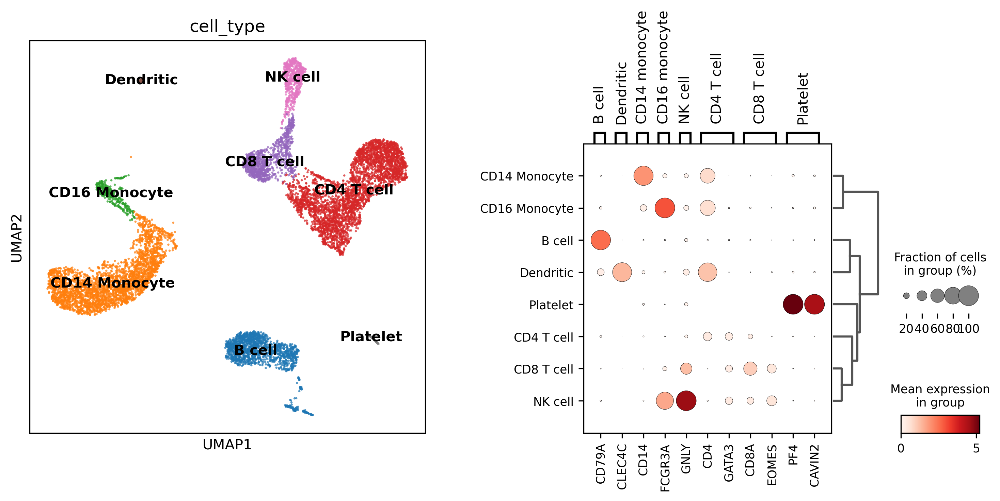

In [192]:
sc.tl.dendrogram(adNorm2, "cell_type")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,5), gridspec_kw={'wspace':0.4})
ax1_dict = sc.pl.umap(adNorm2,color=['cell_type'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm2, marker_genes_dict, 'cell_type', dendrogram=True,ax=ax2, show=False)
plt.show()

We can further plot a PCA projection of the dataset in 3D to help visualize cell type relationships better.

Refining more, we can use normalized expression data and find genes that are differentially expressed in each cell type, statistically ranking to identify marker genes for each cell type. We filter out the weakly expressed genes to prevent false positives and focus on genes that actually define the cell type. We can then visualize these with another dotplot for the top few marker genes per cell type.

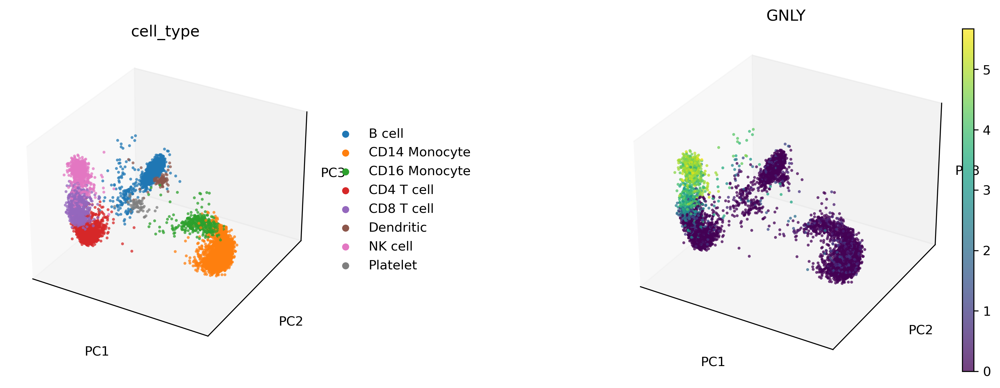

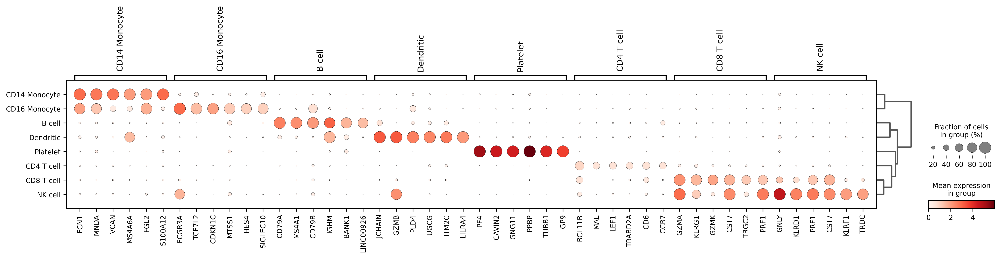

In [194]:
sc.pl.pca(adNorm2, color=['cell_type', 'GNLY'], alpha=.75, s=15, projection='3d')

#remove any likely doublets by identifying genes preferentially expressed in each cluster vs all the others
sc.tl.rank_genes_groups(adNorm2, use_raw=False, groupby="cell_type")

#only display genes that meet criteria
sc.tl.filter_rank_genes_groups(adNorm2, min_fold_change=.7, min_in_group_fraction=.5, max_out_group_fraction=.15)

#dot plot of differentially expressed genes
sc.pl.rank_genes_groups_dotplot(adNorm2, n_genes=6, groupby="cell_type", dendrogram=True, key='rank_genes_groups_filtered')